#### Cose da fare:

-usare il pctchange della media mobile invece che del prezzo in se

-creare uno script che da il via ad una ricerca dei parametri, ottimizzare tramite regressione polinomiale multipla (bisogna trovare i parametri che fittano meglio la regressione nella figura 3d) 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


#Inputs
#------------------------------------------------------------------------------------------------
mywindow = int(input("Enter window size:"))
myforwardwindow = int(input("Enter forward window size:"))
plot_price = input("Do you want to plot the price? (y/n):") == 'y'
#------------------------------------------------------------------------------------------------

#Data reading
path = r'C:\Users\camere\Conda_3.11_enviroment\CSV DATA\1min data\brent 1m.csv'
price = pd.read_csv(path, index_col=0, parse_dates=True)

#Regression variables
#-------------------------------------------------------------------------------------------------------
price["rolling_sd"] = price["close"].rolling(window=mywindow).std() #30mins rolling standard deviation
price["rolling_returns"] = price["close"].rolling(mywindow)
price["forward_returns"] = price["close"].pct_change(-myforwardwindow)
#-------------------------------------------------------------------------------------------------------



if plot_price:
    # Create a subplot with 2 rows and 1 column
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8))
    # Plot the original closing prices on the first axis
    ax1.plot(price.index, price["close"], label='Close Price')
    ax1.set_title('Brent Close Price')
    ax1.set_xlabel('Date')
    ax1.set_ylabel('Price')
    ax1.legend()
    # Plot the rolling standard deviation on the second axis
    ax2.plot(price.index, price["rolling_sd"], label='Rolling Std Dev (30 mins)', color='orange')
    ax2.set_title('Rolling Standard Deviation (30 mins)')
    ax2.set_xlabel('Date')
    ax2.set_ylabel('Standard Deviation')
    ax2.legend()
    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

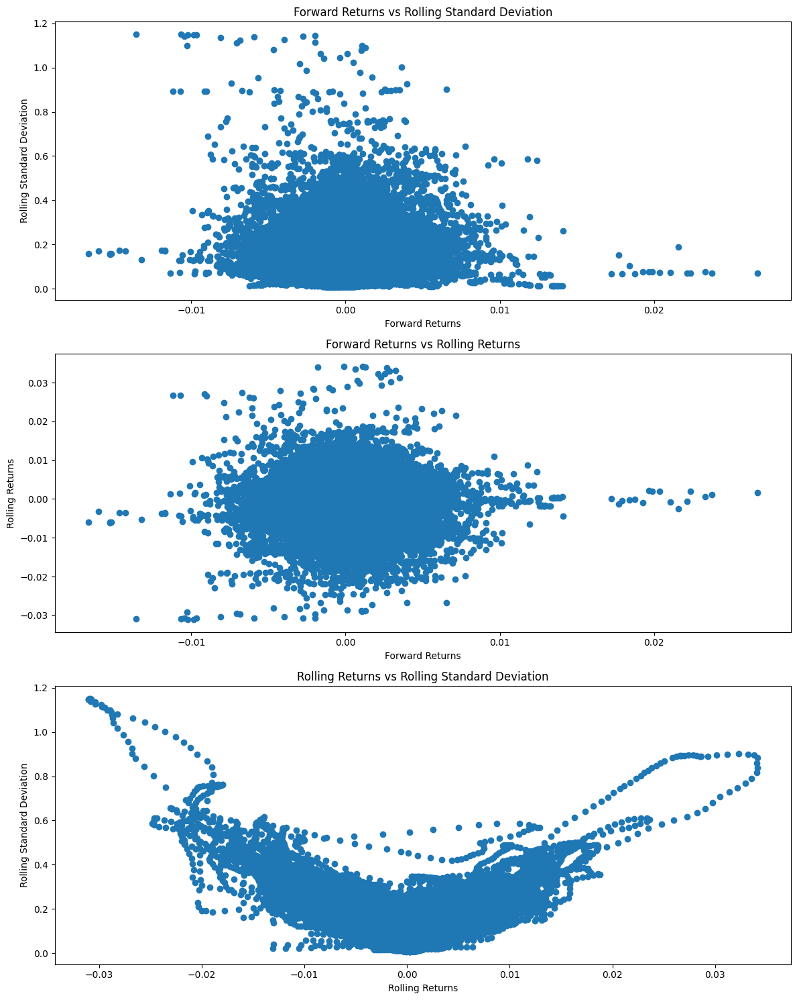

In [2]:
#make a scatter plot of the closing price and the rolling standard deviation
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(12, 15))

ax1.scatter(price["forward_returns"], price["rolling_sd"])
ax1.set_title('Forward Returns vs Rolling Standard Deviation')
ax1.set_xlabel('Forward Returns')
ax1.set_ylabel('Rolling Standard Deviation')

ax2.scatter(price["forward_returns"], price["rolling_returns"])
ax2.set_title('Forward Returns vs Rolling Returns')
ax2.set_xlabel('Forward Returns')
ax2.set_ylabel('Rolling Returns')

ax3.scatter(price["rolling_returns"], price["rolling_sd"])
ax3.set_title('Rolling Returns vs Rolling Standard Deviation')
ax3.set_xlabel('Rolling Returns')
ax3.set_ylabel('Rolling Standard Deviation')

plt.tight_layout()
plt.show()

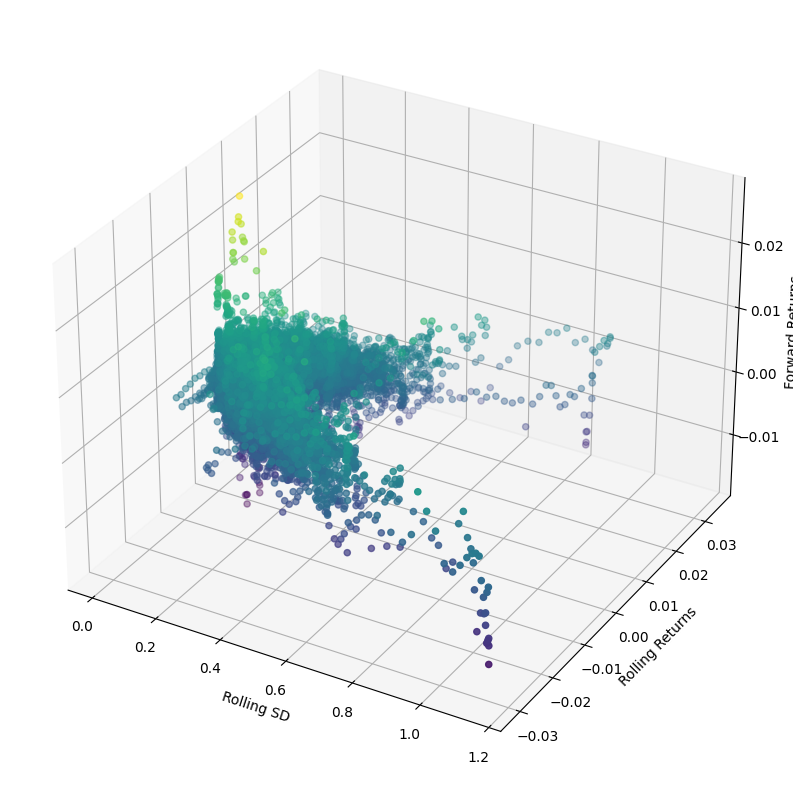

In [3]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')

x = price["rolling_sd"]
y = price["rolling_returns"]
z = price["forward_returns"]

# Plot the data as a 3D scatter plot
ax.scatter(x, y, z, c=z, cmap='viridis')

# Set labels
ax.set_xlabel('Rolling SD')
ax.set_ylabel('Rolling Returns')
ax.set_zlabel('Forward Returns')

plt.show()

In [4]:
import plotly.graph_objects as go

# Calculate forward returns with a positive window
price["forward_returns"] = price["close"].pct_change(-myforwardwindow)

x = price["rolling_sd"]
y = price["rolling_returns"]
z = price["forward_returns"]

# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(
        size=5,
        color=z,  # Set color to the forward returns
        colorscale='Viridis',
        opacity=0.8
    )
)])

# Set labels
fig.update_layout(
    scene=dict(
        xaxis_title='Rolling SD',
        yaxis_title='Rolling Returns',
        zaxis_title='Forward Returns'
    ),
    width = 1000,
    height=800
)

# Show the plot
fig.show()